# VanMoof's Capital Bikeshare Project - Exploratory Data Analysis Notebook

#### Developed by Wei-Yu Tseng

## Package Import

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.image as mpimg
import datetime as dt
import calendar

## Data Import

In [2]:
path='/Users/weiyut/Downloads/cleaned_bike_data_2019.csv'
bike = pd.read_csv(path)

/Users/weiyut/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning: Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [3]:
# Extract month data for each observation
month = map(lambda x: dt.datetime.strptime(x, "%Y-%m-%d").month, bike['Start_day'])
bike['month'] = list(month)

In [4]:
# Rescale bike availability to percentage
bike['Average Bike Availability(%)'] = bike['percent_full']*100

### The function to plot the average bike availability of a particular station or overall

In [5]:
def station_aval(station = False, plot = False):
    # If input station id, extract the weekday, month, bike availability data of that station from the dataset.
    if station:
        temp = bike[bike['station_name'] == station][['month','percent_full','weekend_flag']]
    # If no input for station argument, return the weekday, month, bike availability data of all stations.  
    else:
        temp = bike[['month','percent_full','weekend_flag']]
    
    # Calculate the number of counts and average bike availablity for each month.
    temp = temp.groupby(['month'])['percent_full'].agg(['mean','count'])
    
    # If input station id and plot argument, display the barplot of bike availability of that particular station by month.
    if plot == True and station: 
        sns.set(font_scale = 2)
        sns.set_style("whitegrid")
        plt.figure(figsize=(20,8))
        ax=sns.barplot(x=temp.index, y=100*temp['mean'], color= '#6FBAA7')
        plt.ylim(temp['mean'].min()-0.05,temp['mean'].max()+0.02)
        ax.set_ylabel('Average Bike Availability(%)')
        ax.set_xlabel('Month') 
        ax.set_title('Bike station - '+station)
    # If only input plot argument, display the barplot of bike availability of the all stations by month.    
    elif plot == True:
        sns.set(font_scale = 2)
        sns.set_style("whitegrid")
        plt.figure(figsize=(20,8))
        ax=sns.barplot(x=temp.index, y=100*temp['mean'], color= '#6FBAA7')
        plt.ylim(40,50)
        ax.set_ylabel('Average Bike Availability(%)')
        ax.set_xlabel('Month')
        ax.set_xticklabels(list(calendar.month_name)[1:],rotation = 30)
        ax.set_title('The average bike availability decreases during summer')
    # If no plot argument, return the numerical values of average bike availability by month.
    else:
        return temp

# Overall average bike availability of 2019 (by month)

#### The barplot of average bike availability by month in 2019 suggests that the average bike availability decreases during summer.

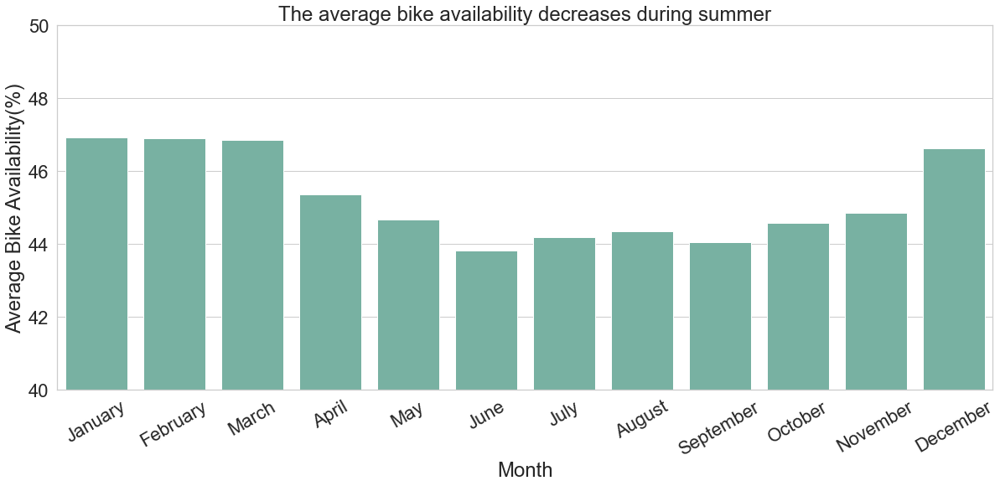

In [6]:
station_aval(plot = True)

# Weekends vs weekdays Comparison in 2019

#### The line chart of hourly average bike availability in 2019 suggests that the bike availability on weekends and weekdays are comparable.

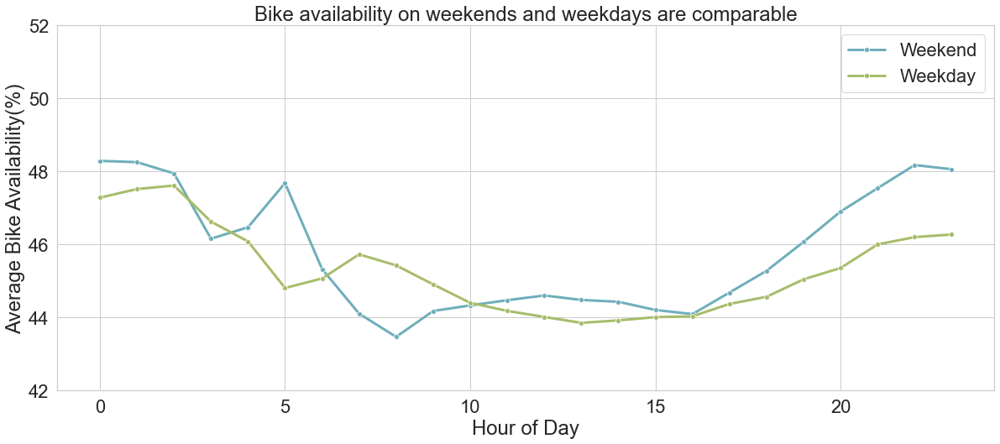

In [7]:
sns.set_style("whitegrid")
palette ={1: "#A7BC6A", 0: "#6FAEBA"}
plt.figure(figsize=(20,8))
ax = sns.lineplot(y='Average Bike Availability(%)',x="start_hour", estimator = np.mean, data=bike, hue='weekend_flag',  palette=palette, ci = None, linewidth = 3, marker = 'o')
ax.set_ylabel('Average Bike Availability(%)')
ax.set_xlabel('Hour of Day') 
ax.set_ylim(42, 52)
plt.legend(title='', loc='upper right', labels=['Weekend', 'Weekday'])
plt.title('Bike availability on weekends and weekdays are comparable')
plt.show()

# Location of bikeshare stations

#### The scatterplot shows that there are more stations in downtown area, as well as higher capacity.

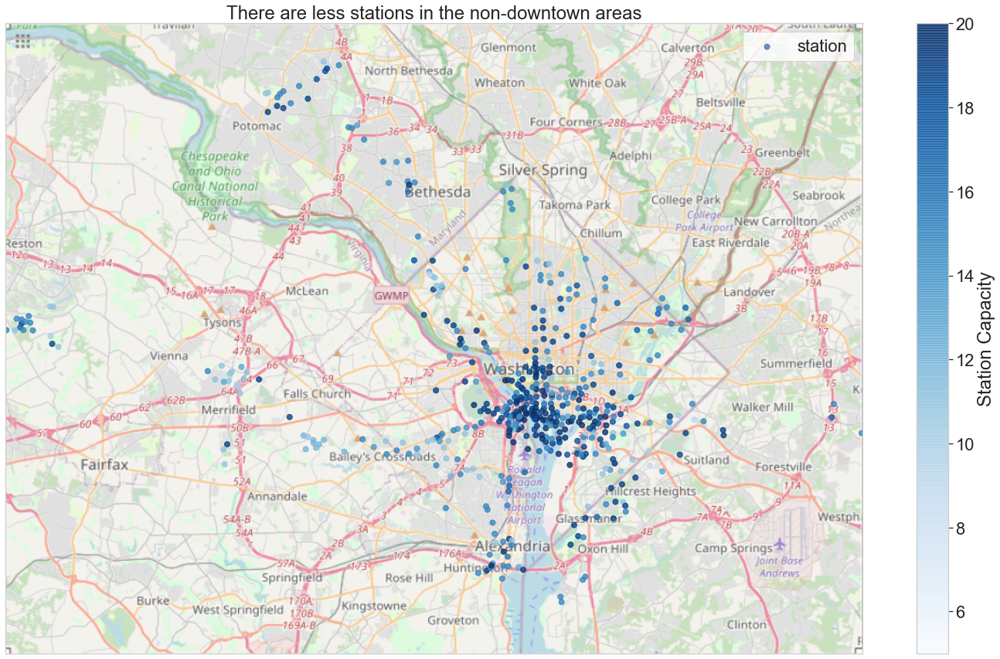

In [8]:
# Load the map of DC metro area.
dc_img=mpimg.imread('https://github.com/Tristal25/Capital_bikeshare_36601/blob/master/data/DCmap.png?raw=true')
bike['Average Bike Availability(%)'] = bike['percent_full']*100
bike['Station Capacity'] = bike['total_capacity'] 
# Group the data by station and calculate it's average bike availability of 2019. 
a  = pd.DataFrame(bike.groupby(['station_name'])[['Average Bike Availability(%)','longitude', 'latitude','Station Capacity']].mean())
# Each scatter on the graph represents a station.
a.plot(kind="scatter", x="longitude", y="latitude", label = 'station'
       # c indicates the color bar, here we plot stations with color gradients represent the capacity of that station. 
       ,c="Station Capacity", cmap=plt.get_cmap("Blues"),
       # For the maximum depth of color bar, we set it to station capcity = 20, which is around the 75 percentil of capcity(21) across all stations.
       # This means for whatever station has capcity larger than 20, it will display the deepest color in the colorbar. 
       # The justification for this move is that the distribution of bike capcity is right-skewed, if we set the max depth to maximum value, it would be hard for us to perceive the pattern. 
        colorbar=True, vmax = 20, alpha=0.8, figsize=(25,15), s = 50
      )
# The range of x-axis is the range of longitude of this map.
plt.xlim(-77.369,-76.825)
# The range of y-axis is the range of latitude of this map.
plt.ylim(38.75,39.15)
plt.ylabel('')
# Overlap the scatterplot on top of the DC map.
plt.imshow(dc_img, alpha=0.8, extent=[-77.369, -76.825, 38.75, 39.15])
plt.title('There are less stations in the non-downtown areas')
plt.xticks([])
plt.yticks([])
plt.show()

### Summary statistics of bikeshare station capacity

In [9]:
# Round the number down to second decimal. 
pd.set_option('display.float_format', lambda x: '%.2f' % x)
bike['Station Capacity'].describe()

count   1543944.00
mean         18.86
std           6.17
min           5.00
25%          15.00
50%          18.00
75%          21.00
max          52.00
Name: Station Capacity, dtype: float64

# Average bike availability by hours throughout the entire 2019 

#### Scatterplot displays shifts in bike availablity hourly.

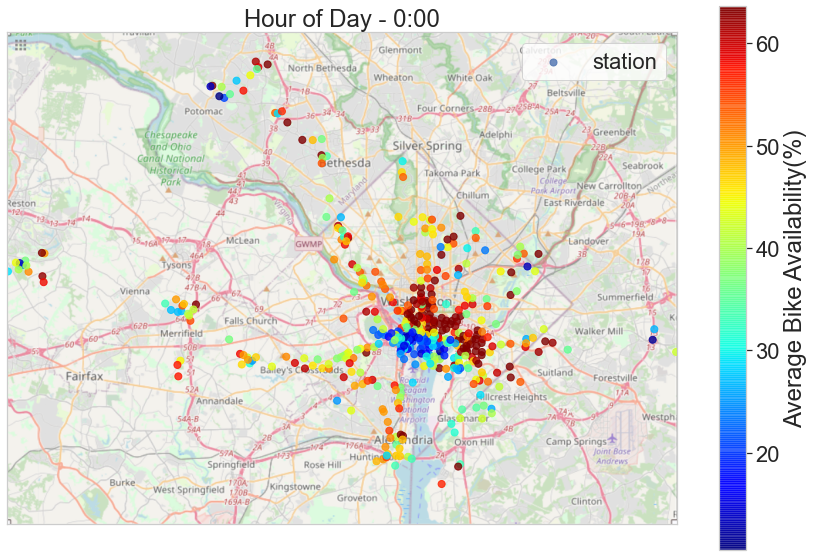

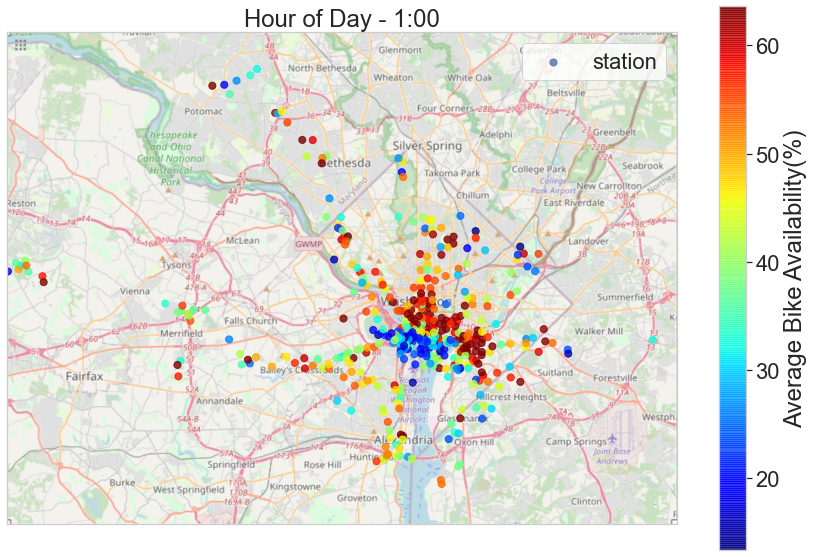

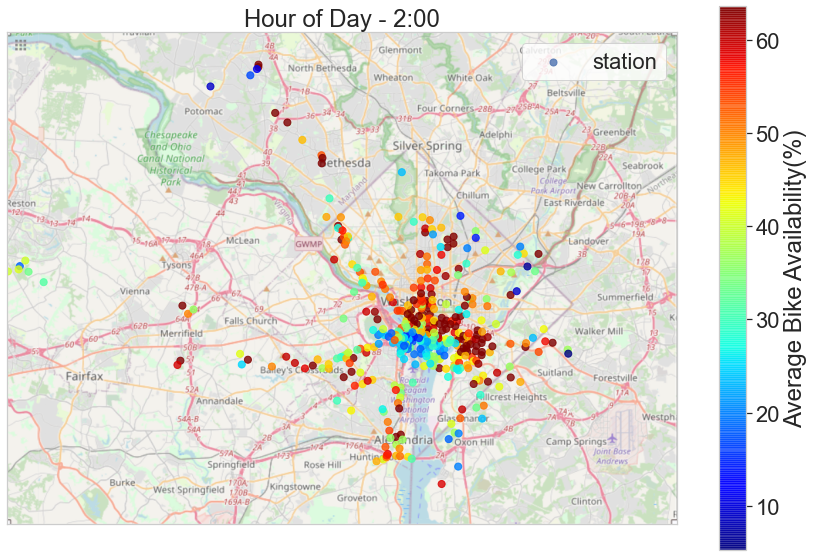

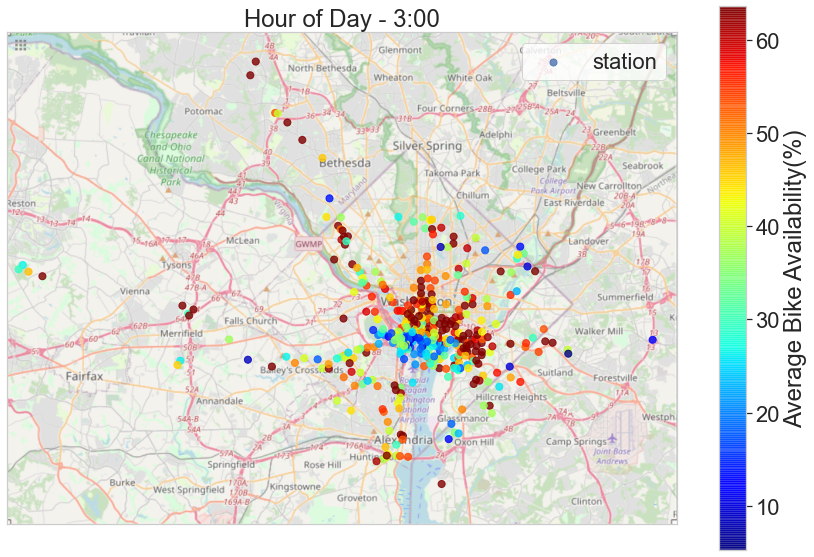

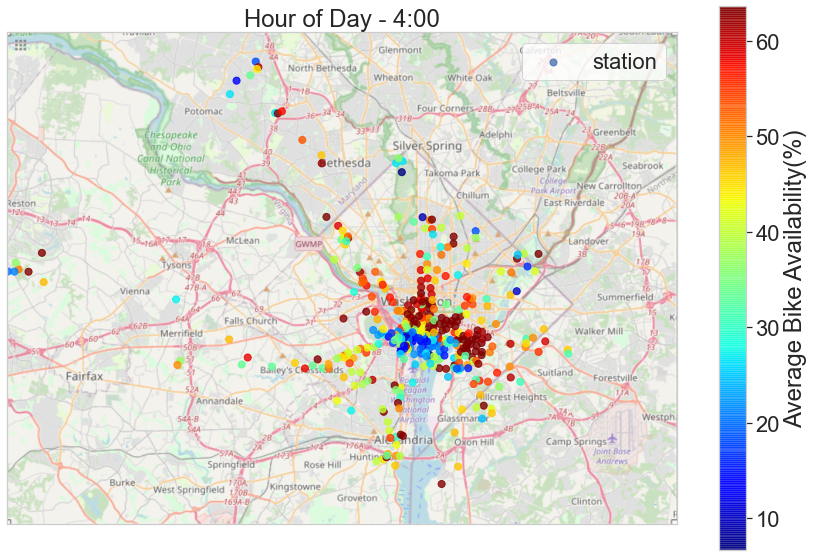

...

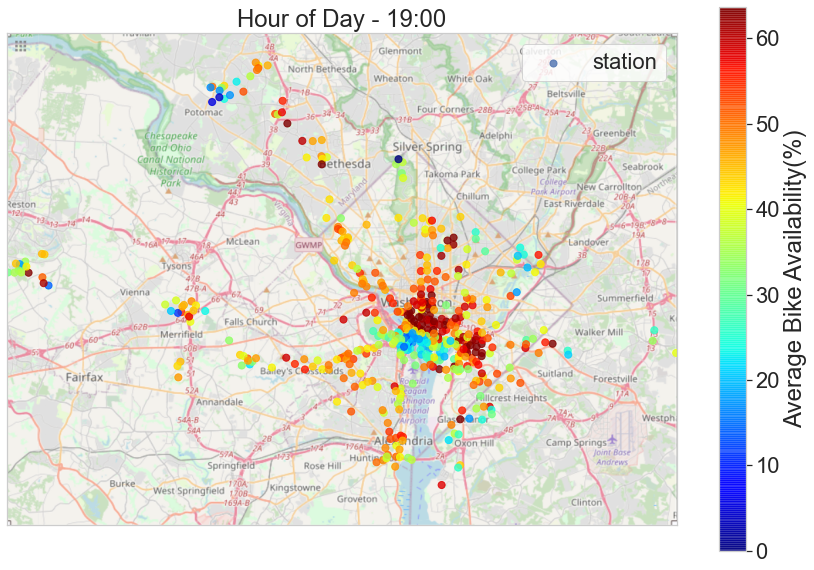

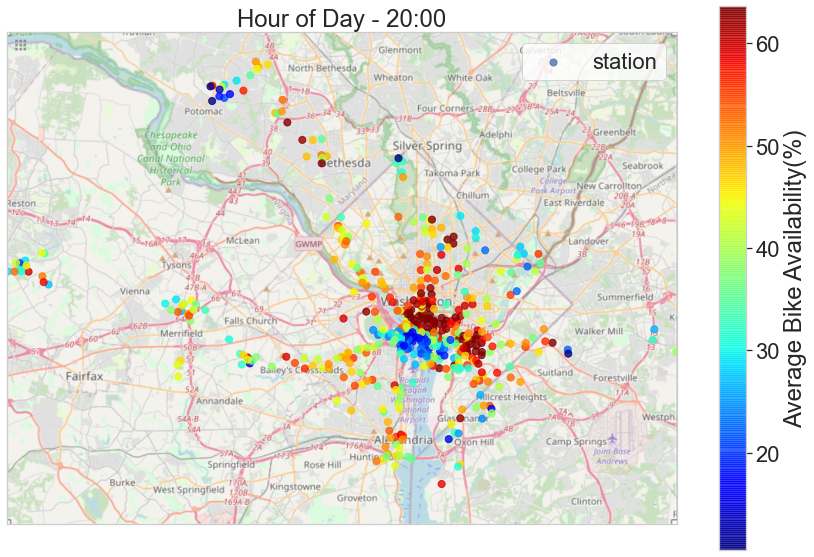

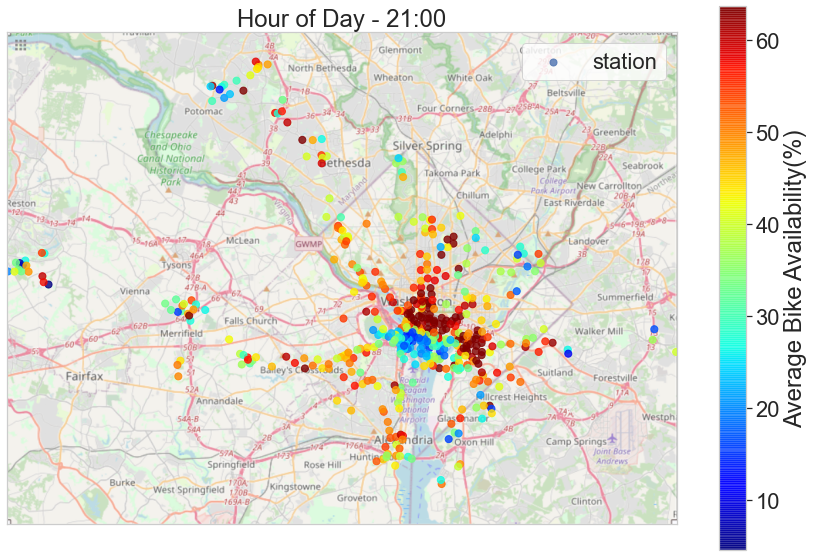

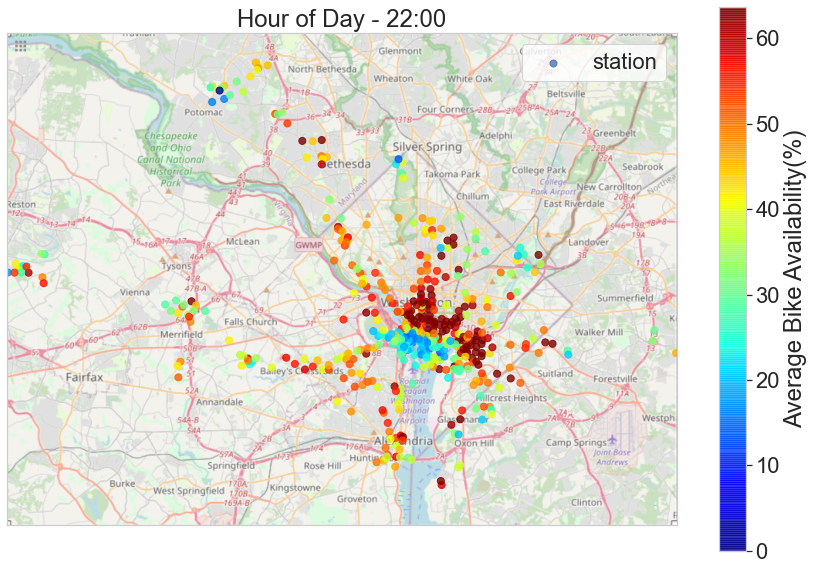

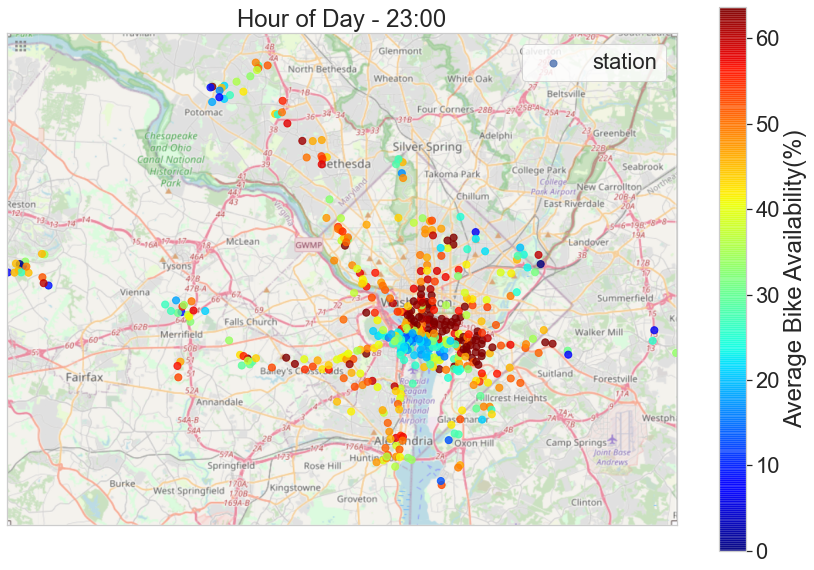

In [10]:
# Plot one graph for each hour, there are 24 hours per day. i denotes the hour of day.  
for i in range(0,24):
    # Group the data by station and calculate it's average bike availability of the particular hour of 2019. 
    a  = pd.DataFrame(bike[bike['start_hour'] == i].groupby(['station_name'])[['Average Bike Availability(%)','longitude', 'latitude']].mean())
    # Each scatter on the graph represents a station.
    a.plot(kind="scatter", x="longitude", y="latitude", label = 'station',
    # c indicates the color bar, here we plot stations with color gradients represent the average bike availability of the hour.
    c="Average Bike Availability(%)", cmap=plt.get_cmap("jet"),
    colorbar=True, alpha=0.8, vmax = bike['percent_full'].describe()['75%']*100, figsize=(15,10), s = 50) 
    # We set the maximum of colorbar equals the 75% percentile, 
    # so once the bike availability exceeds this number, it shows the deepest color in the colorbar.
    # This makes us easier to visualize our bike availability, because the distribution of bike availability is right skewed.
    # If we use the maximum bike availabilty, we wouldn't be able to visualize the difference, since most of the stations would be closer to bluish side. 
    plt.title('Hour of Day - '+ str(i)+':00')
    # The range of x-axis is the range of longitude of this map.
    plt.xlim(-77.369,-76.825)
    # The range of y-axis is the range of latitude of this map.
    plt.ylim(38.75,39.15)
    plt.legend()
    # Overlap the scatterplot on top of the DC map.
    plt.imshow(dc_img, alpha=0.8, extent=[-77.369, -76.825, 38.75, 39.15])
    plt.xticks([])
    plt.yticks([])
    plt.ylabel('')
    plt.show()
    plt.close()
    


# Average bike availability by month throughout the entire 2019 

#### During summer, the average bike availability in downtown area is lower than other season

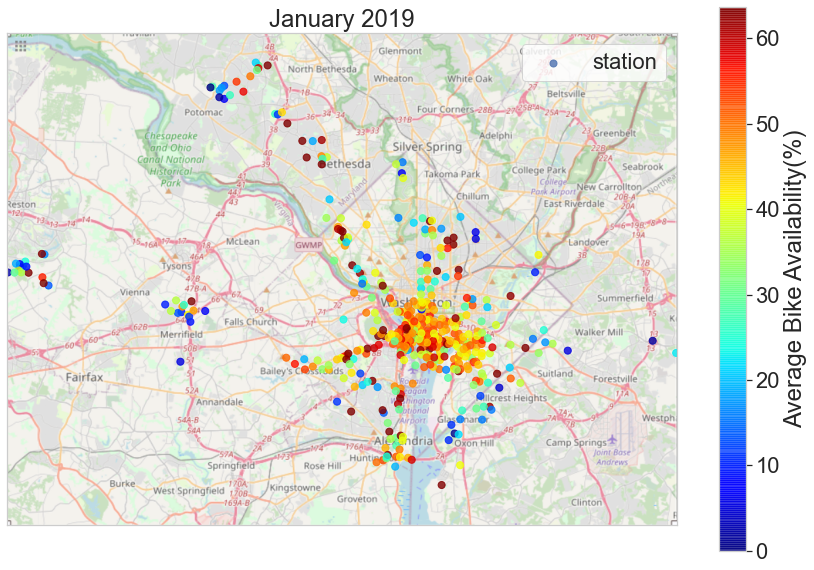

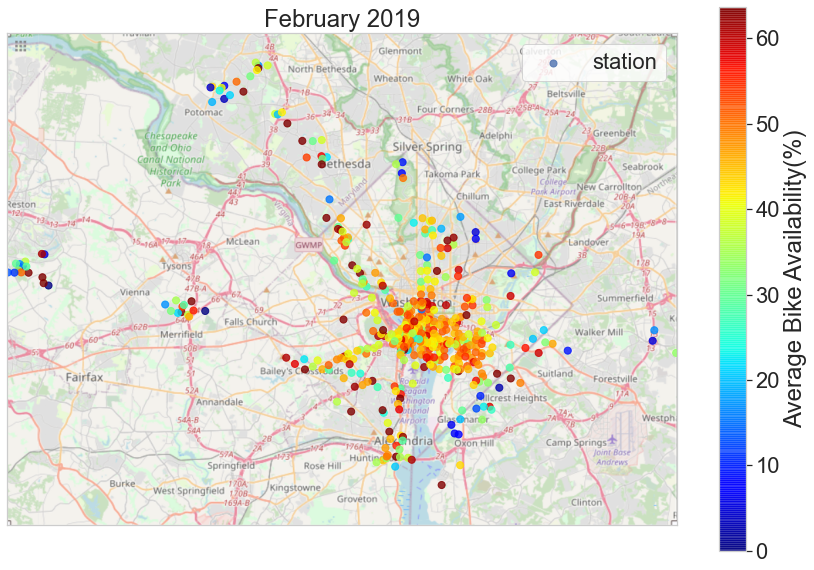

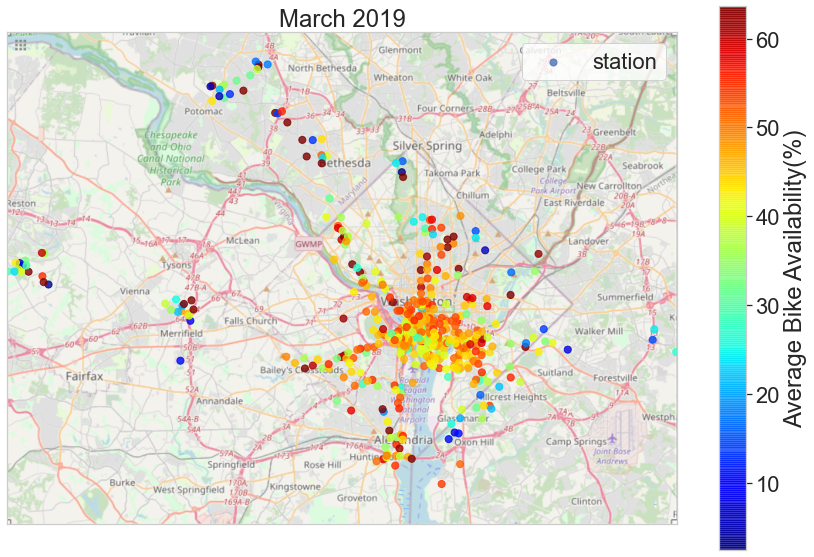

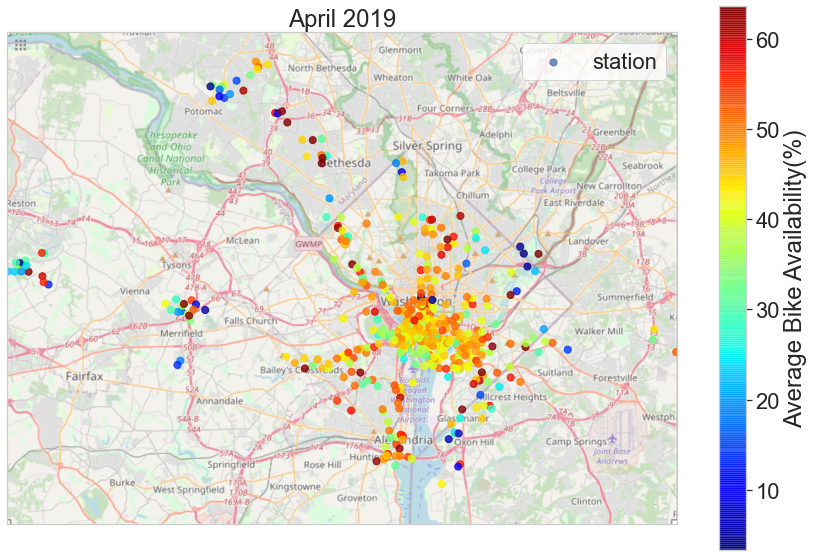

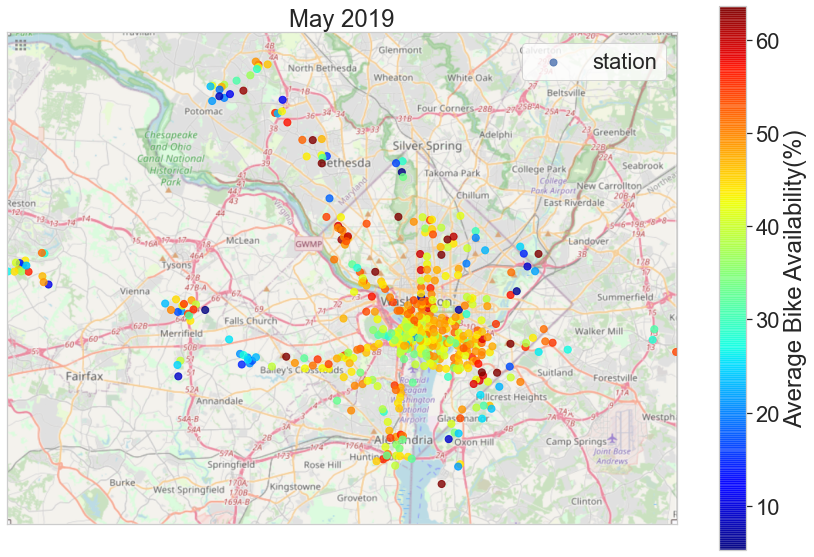

...

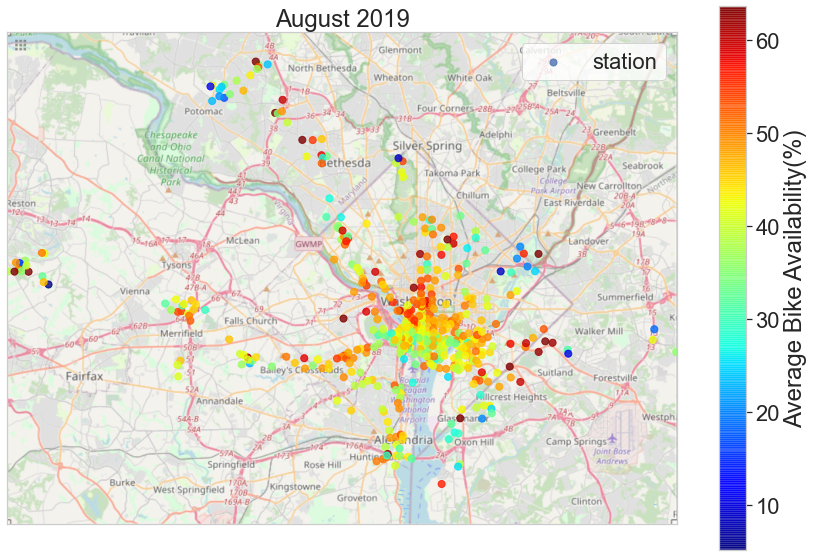

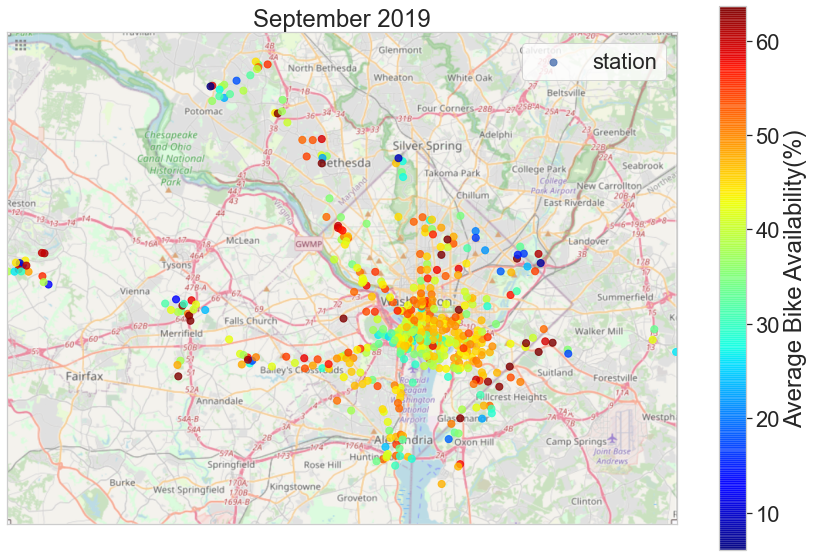

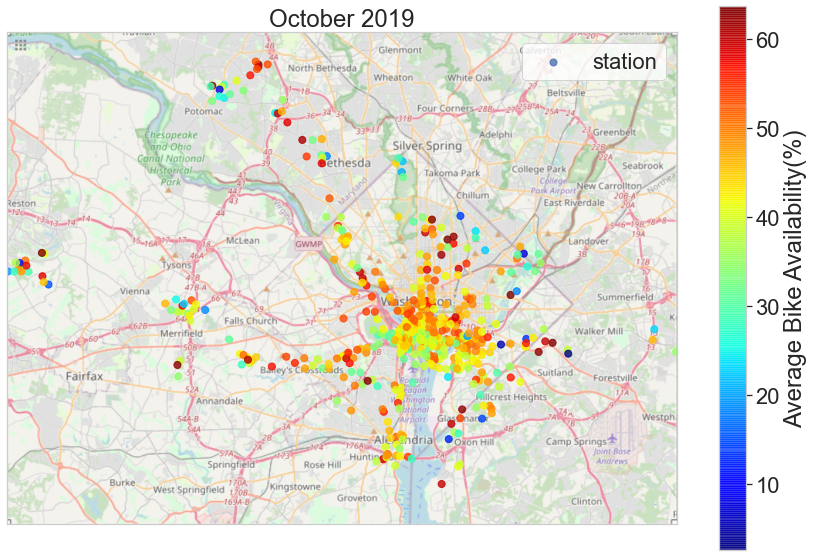

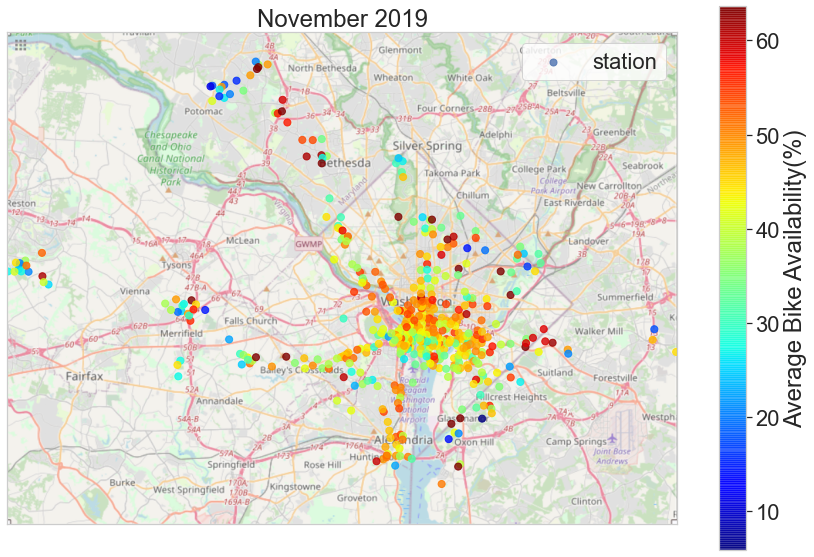

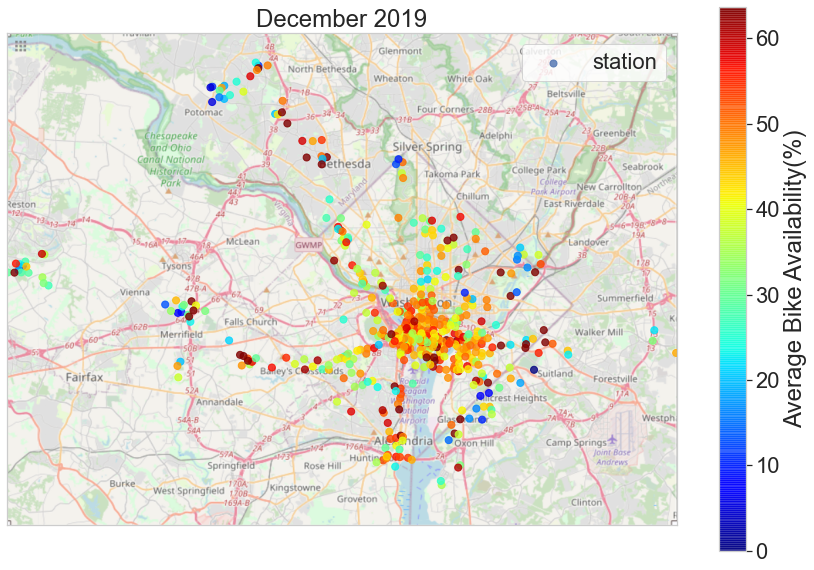

In [11]:
# Plot one graph for each hour, there are 12 months per day. i denotes the month of year. 
for i in range(1,13):
    # Group the data by station and calculate it's average bike availability of the particular month of 2019. 
    m  = pd.DataFrame(bike[bike['month'] == i].groupby(['station_name'])[['Average Bike Availability(%)','longitude', 'latitude']].mean())
    # Each scatter on the graph represents a station.
    m.plot(kind="scatter", x="longitude", y="latitude", label = 'station',
    # c indicates the color bar, here we plot stations with color gradients represent the average bike availability of the month.
    c="Average Bike Availability(%)", cmap=plt.get_cmap("jet"),
    colorbar=True, alpha=0.8, vmax = bike['percent_full'].describe()['75%']*100, figsize=(15,10), s = 50)
    # We set the maximum of colorbar equals the 75% percentile, 
    # so once the bike availability exceeds this number, it shows the deepest color in the colorbar.
    # This makes us easier to visualize our bike availability, because the distribution of bike availability is right skewed.
    # If we use the maximum bike availabilty, we wouldn't be able to visualize the difference, since most of the stations would be closer to bluish side. 
    plt.title(list(calendar.month_name)[i]+' 2019')
    # The range of x-axis is the range of longitude of this map.
    plt.xlim(-77.369,-76.825)
    # The range of y-axis is the range of latitude of this map.
    plt.ylim(38.75,39.15)
    plt.legend()
    # Overlap the scatterplot on top of the DC map.
    plt.imshow(dc_img, alpha=0.8, extent=[-77.369, -76.825, 38.75, 39.15])
    plt.xticks([])
    plt.yticks([])
    plt.ylabel('')
    plt.show()
    plt.close()
    